# 16: Getting Data Missing Values method 2 

In [46]:
phone_missing_values = pd.read_csv("phones_data_missing.csv")
phone_missing_values

,Make,Colour,Memory(kb),Sim Cards,Price
0,0,Nokia,150043.0,4,$400.00
1,1,Ssamung,87899.0,4,$500.00
2,2,Nokia,NaN,3,NaN
3,3,Iphone,11179.0,5,$220.00
4,4,Motorlla,213095.0,4,$350.00
5,5,Nokia,NaN,4,NaN
6,6,Ssamung,45698.0,4,$750.00
7,7,Ssamung,NaN,4,$700.00
8,8,NaN,60000.0,4,$625.00
9,9,Motorlla,31600.0,4,$970.00


In [47]:
phone_missing_values.isna().sum()

Make          0
Colour        1
Memory(kb)    3
Sim Cards     0
Price         2
dtype: int64

In [48]:
phone_missing_values.dropna(subset=['Price'],inplace=True)
phone_missing_values.isna().sum()

Make          0
Colour        1
Memory(kb)    1
Sim Cards     0
Price         0
dtype: int64

In [49]:
X = phone_missing_values.drop('Price',axis=1)
y = phone_missing_values['Price']

# Data filling -->is called Data Imputation 

In [50]:
from sklearn.impute import SimpleImputer
from sklearn.compose import ColumnTransformer
# fill catogiracl with missing and numerical value with mean()

cat_feature = SimpleImputer(strategy='constant',fill_value='missing')
Simcard_feature = SimpleImputer(strategy='constant',fill_value=4)
num_feature = SimpleImputer(strategy='mean')

cat_feature = ["Make","Colour"]
Simcard_feature = ['Sim Card']
num_feature = ['Memory(kb)']

#define column
imputer = ColumnTransformer([('cat_feature',cat_feature,cat_feature),
                             ('Simcard_feature',Simcard_feature,Simcard_feature),
                             ('num_feature',num_feature,num_feature)])
filled_X = imputer.fit_transform(X)
filled_X

TypeError: All estimators should implement fit and transform, or can be 'drop' or 'passthrough' specifiers. '['Make', 'Colour']' (type <class 'list'>) doesn't.

# 17: Choosing Machine Learning Model 

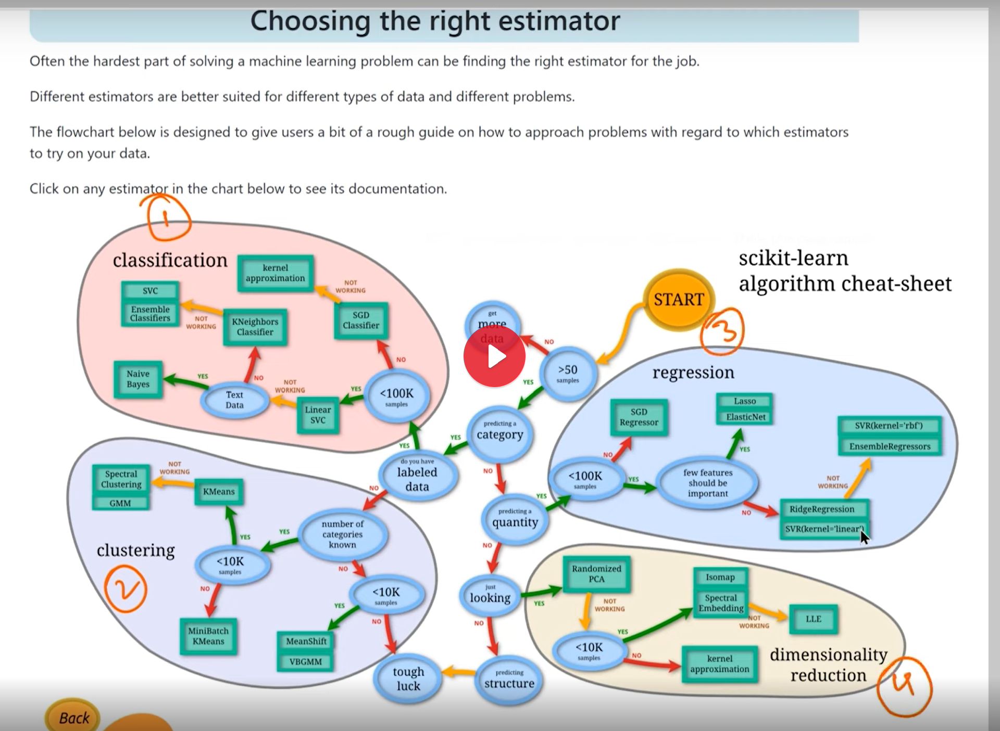

In [51]:
pip install scikit-learn

Note: you may need to restart the kernel to use updated packages.


In [52]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.datasets import load_boston
boston = load_boston()
boston

C:\Users\hp\anaconda3\Lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function load_boston is deprecated; `load_boston` is deprecated in 1.0 and will be removed in 1.2.

    The Boston housing prices dataset has an ethical problem. You can refer to
    the documentation of this function for further details.

    The scikit-learn maintainers therefore strongly discourage the use of this
    dataset unless the purpose of the code is to study and educate about
    ethical issues in data science and machine learning.

    In this special case, you can fetch the dataset from the original
    source::

        import pandas as pd
        import numpy as np

        data_url = "http://lib.stat.cmu.edu/datasets/boston"
        raw_df = pd.read_csv(data_url, sep="\s+", skiprows=22, header=None)
        data = np.hstack([raw_df.values[::2, :], raw_df.values[1::2, :2]])
        target = raw_df.values[1::2, 2]

    Alternative datasets include the California housing dataset (i.e.

{'data': array([[6.3200e-03, 1.8000e+01, 2.3100e+00, ..., 1.5300e+01, 3.9690e+02,
         4.9800e+00],
        [2.7310e-02, 0.0000e+00, 7.0700e+00, ..., 1.7800e+01, 3.9690e+02,
         9.1400e+00],
        [2.7290e-02, 0.0000e+00, 7.0700e+00, ..., 1.7800e+01, 3.9283e+02,
         4.0300e+00],
        ...,
        [6.0760e-02, 0.0000e+00, 1.1930e+01, ..., 2.1000e+01, 3.9690e+02,
         5.6400e+00],
        [1.0959e-01, 0.0000e+00, 1.1930e+01, ..., 2.1000e+01, 3.9345e+02,
         6.4800e+00],
        [4.7410e-02, 0.0000e+00, 1.1930e+01, ..., 2.1000e+01, 3.9690e+02,
         7.8800e+00]]),
 'target': array([24. , 21.6, 34.7, 33.4, 36.2, 28.7, 22.9, 27.1, 16.5, 18.9, 15. ,
        18.9, 21.7, 20.4, 18.2, 19.9, 23.1, 17.5, 20.2, 18.2, 13.6, 19.6,
        15.2, 14.5, 15.6, 13.9, 16.6, 14.8, 18.4, 21. , 12.7, 14.5, 13.2,
        13.1, 13.5, 18.9, 20. , 21. , 24.7, 30.8, 34.9, 26.6, 25.3, 24.7,
        21.2, 19.3, 20. , 16.6, 14.4, 19.4, 19.7, 20.5, 25. , 23.4, 18.9,
        35.4, 24.7, 3

In [71]:
df_boston = pd.DataFrame(boston['data'], columns = boston['feature_names'])
df_boston['target']=pd.Series(boston['target'])
df_boston.head()

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT,target
0,0.00632,18.0,2.31,0.0,0.538,6.575,65.2,4.0900,1.0,296.0,15.3,396.90,4.98,24.0
1,0.02731,0.0,7.07,0.0,0.469,6.421,78.9,4.9671,2.0,242.0,17.8,396.90,9.14,21.6
2,0.02729,0.0,7.07,0.0,0.469,7.185,61.1,4.9671,2.0,242.0,17.8,392.83,4.03,34.7
3,0.03237,0.0,2.18,0.0,0.458,6.998,45.8,6.0622,3.0,222.0,18.7,394.63,2.94,33.4
4,0.06905,0.0,2.18,0.0,0.458,7.147,54.2,6.0622,3.0,222.0,18.7,396.90,5.33,36.2


![11.png](attachment:11.png)

In [53]:
len(df_boston)

NameError: name 'df_boston' is not defined

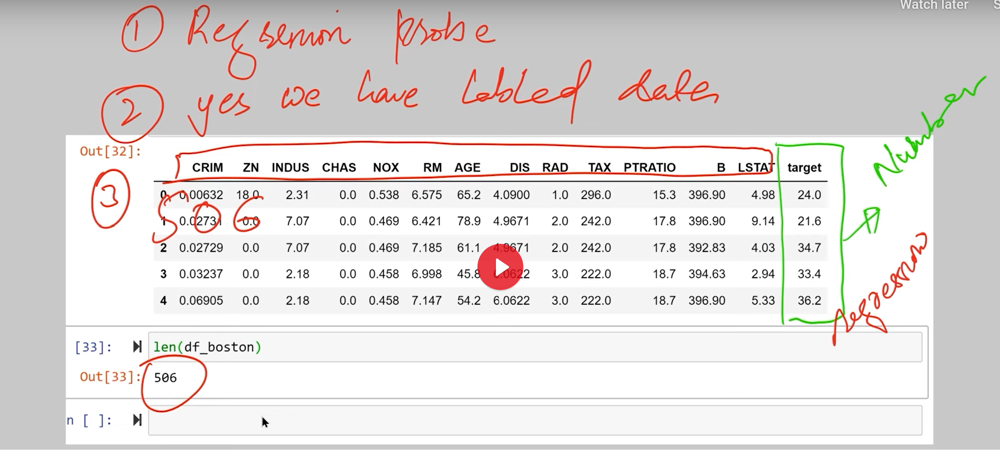

In [54]:
from sklearn.linear_model import Ridge
from sklearn.model_selection import train_test_split

import numpy as np
np.random.seed(1)
X = df_boston.drop("target" ,axis=1)
y = df_boston["target"]
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size =.20)
reg_model =  Ridge()
reg_model.fit(X_train,y_train)
reg_model.score(X_test,y_test)

NameError: name 'df_boston' is not defined

# 19: Step 2 How to Choose Better model 

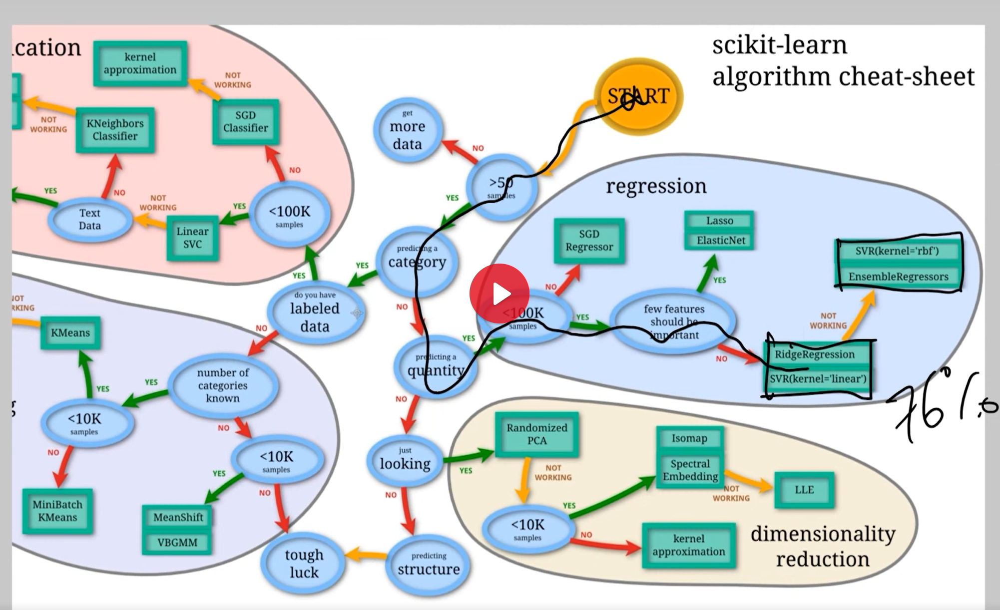

In [69]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split

import numpy as np
np.random.seed(1)

X = df_boston.drop("target" ,axis=1)
y = df_boston["target"]
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size =.20)
rf_model =  RandomForestRegressor()
rf_model.fit(X_train,y_train)
rf_model.score(X_test,y_test)

NameError: name 'df_boston' is not defined

# 20: Choosing Model for Classification problem 

In [56]:
heart_disease = pd.read_csv('heart.csv')
heart_disease.head()

,age,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,target
0,52,1,0,125,212,0,1,168,0,1.0,2,2,3,0
1,53,1,0,140,203,1,0,155,1,3.1,0,0,3,0
2,70,1,0,145,174,0,1,125,1,2.6,0,0,3,0
3,61,1,0,148,203,0,1,161,0,0.0,2,1,3,0
4,62,0,0,138,294,1,1,106,0,1.9,1,3,2,0


In [57]:
len(heart_disease)

1025

# 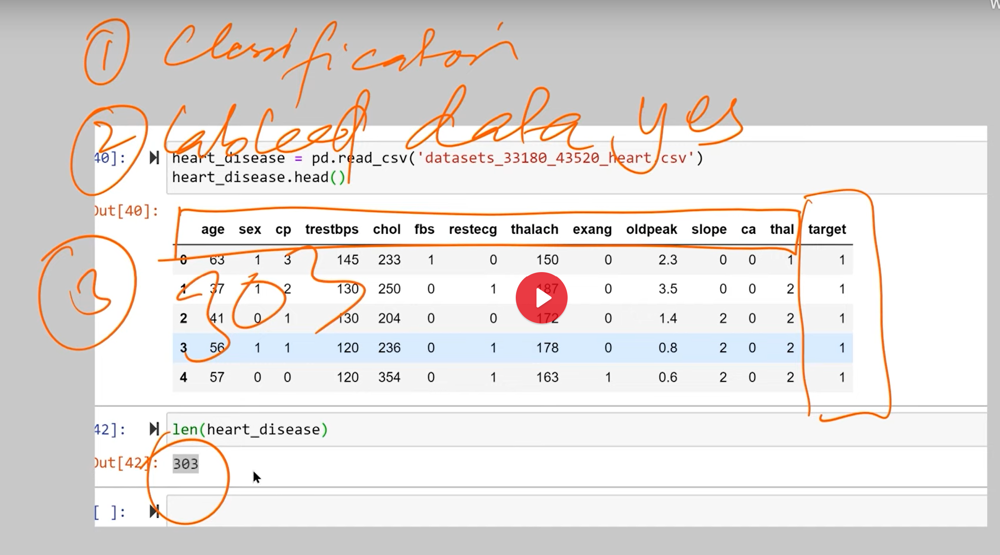

In [58]:
from sklearn.svm import LinearSVC
from sklearn.model_selection import train_test_split

import numpy as np
np.random.seed(1)
X = heart_disease.drop("target" ,axis=1)
y = heart_disease["target"]
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size =.20)
svc_model =  LinearSVC()
svc_model.fit(X_train,y_train)
svc_model.score(X_test,y_test)

C:\Users\hp\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1225: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


0.7365853658536585

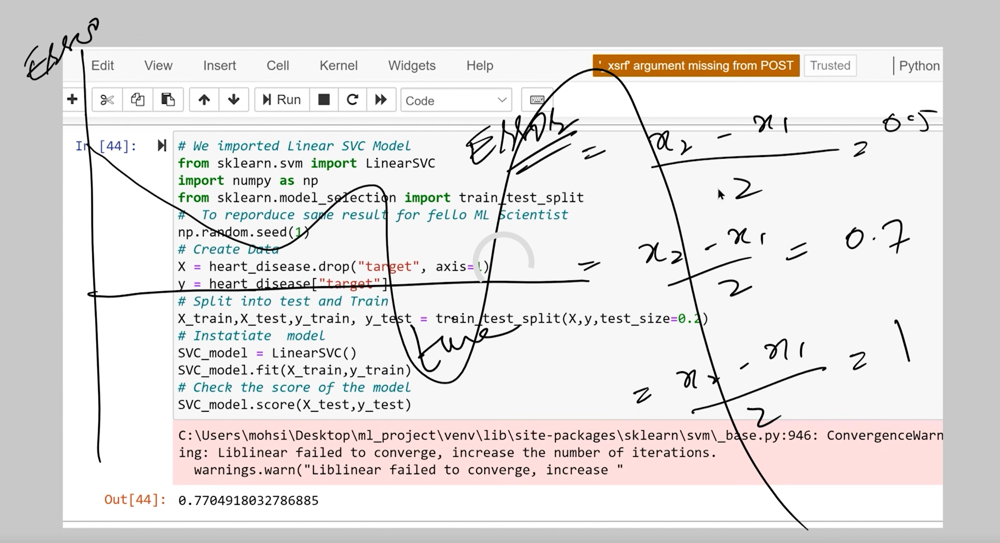

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
import numpy as np

np.random.seed(1)

X = heart_disease.drop("target" ,axis=1)
y = heart_disease["target"]
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size =.20)
RFC_model =  RandomForestClassifier()
RFC_model.fit(X_train,y_train)
RFC_model.score(X_test,y_test)

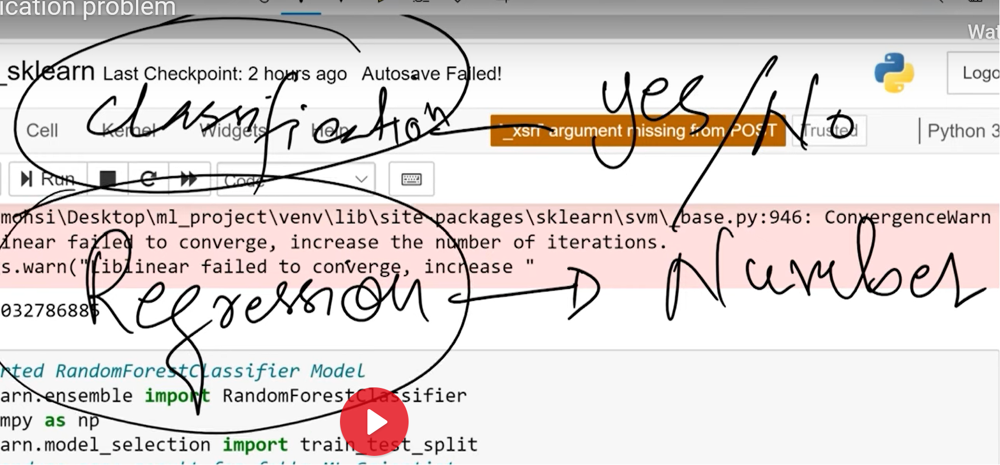

# structued data -->ensable method prefer
#  unstructerd data--> deep learning 

# 21: Fit the Model 

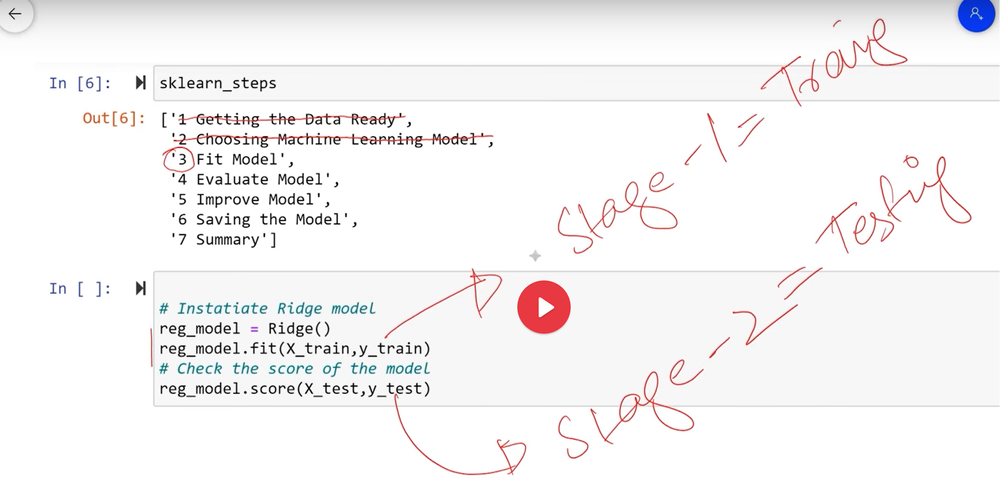# 

# 22: Running Prediction 

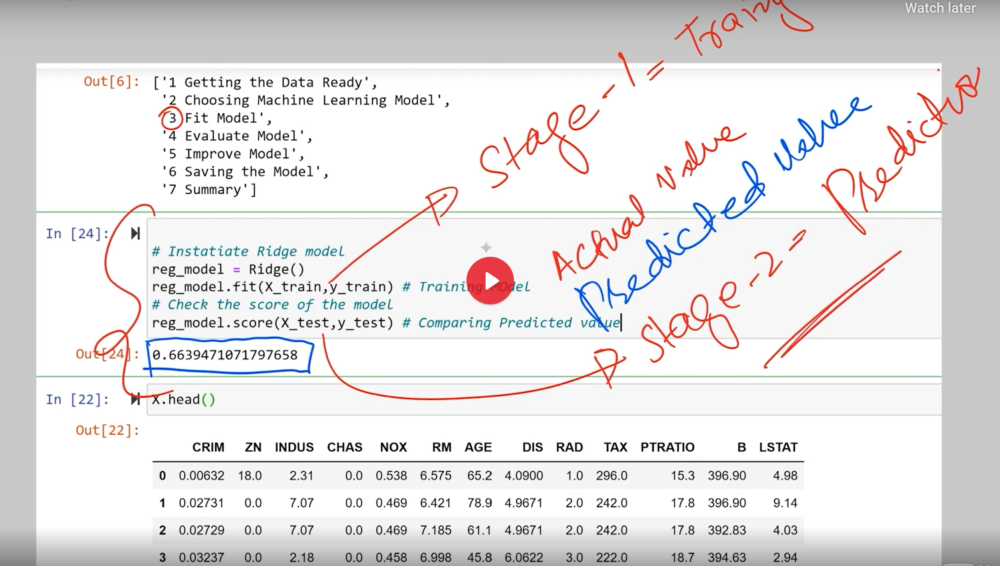

In [59]:
heart_disease = pd.read_csv('heart.csv')
heart_disease.head()

,age,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,target
0,52,1,0,125,212,0,1,168,0,1.0,2,2,3,0
1,53,1,0,140,203,1,0,155,1,3.1,0,0,3,0
2,70,1,0,145,174,0,1,125,1,2.6,0,0,3,0
3,61,1,0,148,203,0,1,161,0,0.0,2,1,3,0
4,62,0,0,138,294,1,1,106,0,1.9,1,3,2,0


In [60]:
X = heart_disease.drop("target",axis=1)
y = heart_disease['target']

In [61]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
import numpy as np

np.random.seed(1)

X = heart_disease.drop("target" ,axis=1)
y = heart_disease["target"]

X_train,X_test,y_train,y_test = train_test_split(X,y,test_size =.20)
clf =  RandomForestClassifier()
clf.fit(X_train,y_train)

y_predicted = clf.predict(X_test)
y_predicted

array([0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0,
       0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0,
       0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0,
       0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0,
       1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0,
       0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0,
       0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0,
       1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0,
       1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0,
       0, 1, 0, 1, 0, 1, 0], dtype=int64)

In [62]:
np.array(y_test)

array([0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0,
       0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0,
       0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0,
       0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0,
       1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0,
       0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0,
       0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0,
       1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0,
       1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0,
       0, 1, 0, 1, 0, 1, 0], dtype=int64)

In [63]:
np.mean(y_test == y_predicted)  #method 1

1.0

In [64]:
clf.score(X_test,y_test)  #method 2

1.0

In [65]:
from sklearn.metrics import accuracy_score   #method 3
accuracy_score(y_test,y_predicted)

1.0

# 23: Step 3 predict proba method 

In [66]:
clf.predict(X_test)[:5]

array([0, 1, 1, 0, 0], dtype=int64)

In [67]:
clf.predict_proba(X_test)[:5]

array([[0.98, 0.02],
       [0.03, 0.97],
       [0.03, 0.97],
       [0.87, 0.13],
       [0.99, 0.01]])

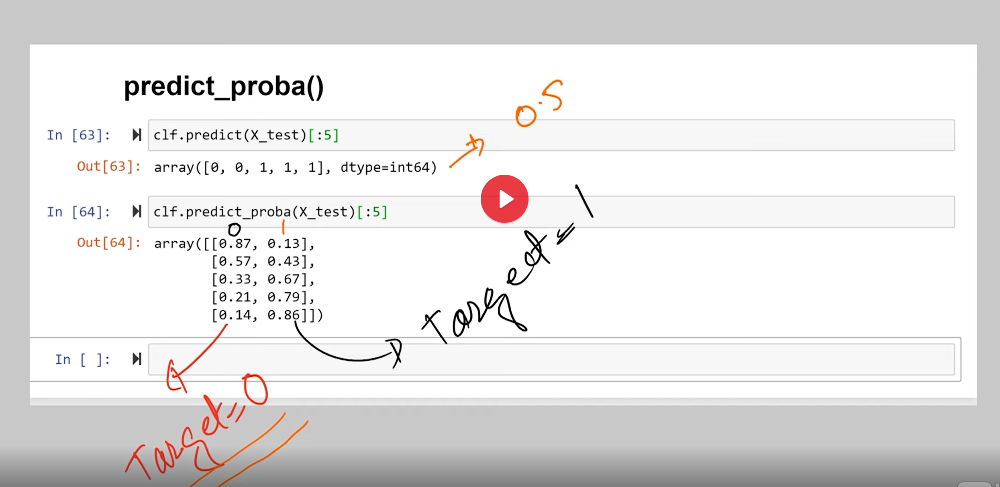

# 24: Step 3 Running Prediction on Regression 

In [68]:
df_boston

NameError: name 'df_boston' is not defined

In [ ]:
from sklearn.ensemble import RandomForestRegressor
np.random.seed(1)
X = df_boston.drop("target",axis =1)
y = df_boston["target"]

X_train,X_test,y_train,y_test = train_test_split(X,y,test_size =.20)
Regressor =  RandomForestRegressor()
Regressor.fit(X_train,y_train)

y_predicted = Regressor.predict(X_test)
y_predicted[:10]

In [ ]:
np.array(y_test[:10])

In [ ]:
from sklearn.metrics import mean_absolute_error
mean_absolute_error(y_test,y_predicted)

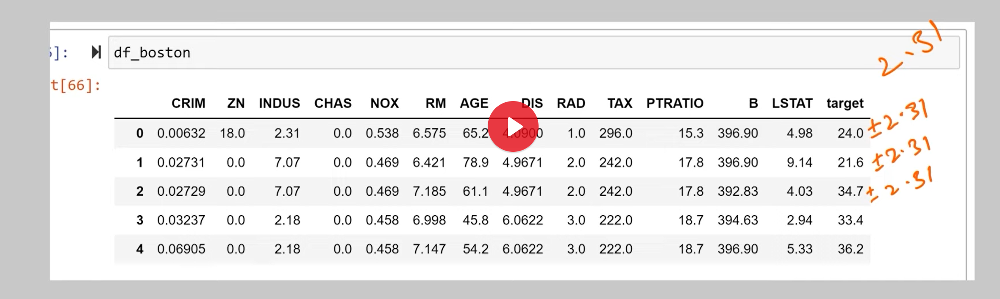

# 25: Step 4 Evaluating Machine Learning Model
# 3ways
# 1- estimator and score method
# 2-The scoring parameter
# 3-problem specific metric function

In [ ]:
from sklearn.ensemble import RandomForestClassifier
np.random.seed(1)
X = heart_disease.drop("target",axis=1)
y = heart_disease["target"]

In [ ]:
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size =.20)
clf =  RandomForestClassifier()
clf.fit(X_train,y_train)

In [ ]:
clf.score(X_test,y_test)

# Let apply on regression problem

In [72]:
from sklearn.ensemble import RandomForestRegressor
np.random.seed(4)
df_boston
X = df_boston.drop("target",axis=1)
y = df_boston["target"]

X_train,X_test,y_train,y_test = train_test_split(X,y,test_size =.20)
boston_Model =  RandomForestRegressor().fit(X_train,y_train)
boston_Model.score(X_test,y_test)


0.8130380078489517

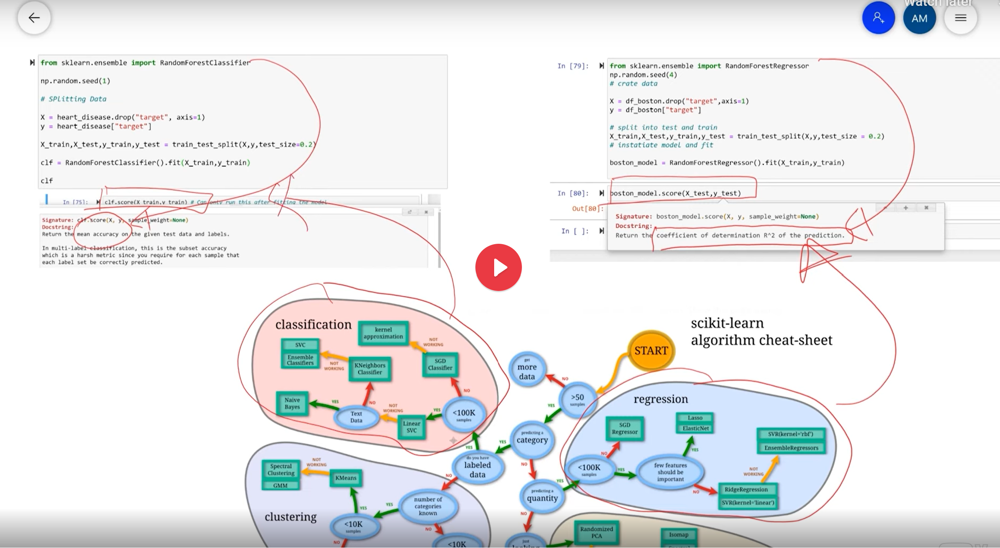

# 26: Step 4 WHat is Cross Validation 

In [73]:
from sklearn.ensemble import RandomForestClassifier
np.random.seed(1)
X = heart_disease.drop("target",axis=1)
y = heart_disease["target"]

X_train,X_test,y_train,y_test = train_test_split(X,y,test_size =.20)
clf =  RandomForestClassifier()
clf.fit(X_train,y_train)


1.0

In [74]:
from sklearn.model_selection import cross_val_score
cross_val_score (clf,X,y,cv=5) #normal score method

array([1.        , 1.        , 1.        , 1.        , 0.98536585])

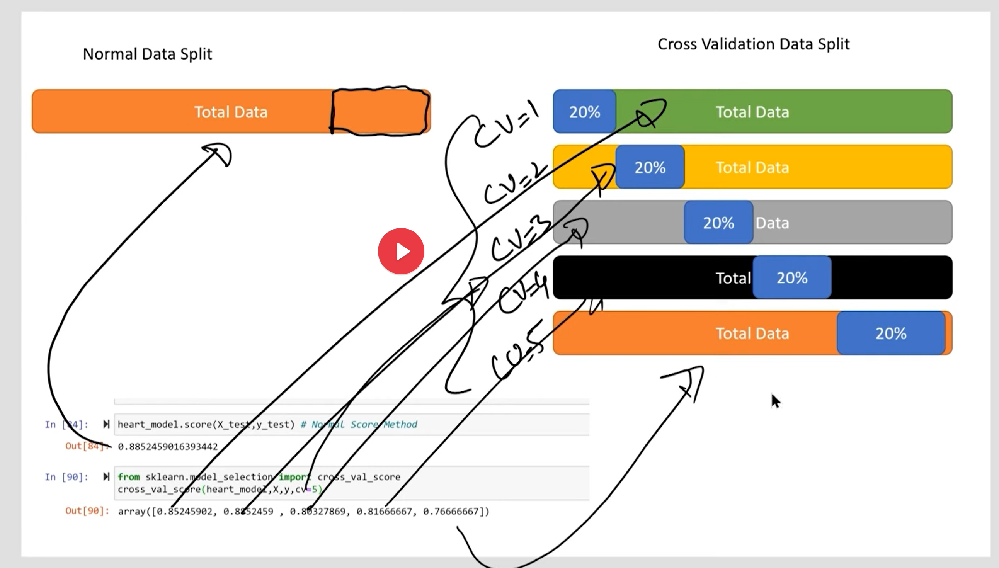

In [75]:
np.mean(cross_val_score (clf,X,y,cv=5)) #normal score method

0.9970731707317073

# 27: Step 4 Accuracy Classification Model 

# Accuracy 
# AUC ROC(Reciever Operator curve)
# Confusion Matrix
# classification Reeport

In [80]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score

np.random.seed(1)
X = heart_disease.drop("target",axis=1)
y = heart_disease["target"]

X_train,X_test,y_train,y_test = train_test_split(X,y,test_size =.20)
clf =  RandomForestClassifier()
clf.fit(X_train,y_train)



RandomForestClassifier()

In [83]:
cross_val_score (clf,X,y,cv=5) #normal score method

array([1.        , 1.        , 1.        , 1.        , 0.98536585])

In [84]:
print("heart disease cross validation acurcy:",np.mean(cross_val_score (clf,X,y,cv=5)))

heart disease cross validation acurcy: 0.9970731707317073


# 28: Step 4 Area Under the Curve Part 1 

In [111]:
from sklearn.metrics import roc_auc_score

X_train,X_test,y_train,y_test = train_test_split(X,y,test_size =.20)
clf.fit(X_train,y_train)

RandomForestClassifier()

In [112]:
# Predict using proba method 
y_proba = clf.predict_proba(X_test)
y_proba[:5]

array([[0.  , 1.  ],
       [0.02, 0.98],
       [0.02, 0.98],
       [0.04, 0.96],
       [0.96, 0.04]])

In [113]:
y_prob_possitive = y_proba[:,1]

In [114]:
y_prob_possitive

array([1.  , 0.98, 0.98, 0.96, 0.04, 1.  , 0.97, 0.96, 0.02, 0.  , 0.99,
       0.08, 0.88, 0.07, 1.  , 0.  , 0.02, 0.14, 0.07, 0.01, 0.07, 0.94,
       0.13, 0.95, 0.97, 0.04, 0.97, 0.07, 0.02, 0.01, 0.92, 0.08, 0.02,
       0.05, 0.01, 0.99, 0.02, 0.01, 0.  , 0.97, 0.02, 0.06, 0.93, 0.08,
       0.89, 0.89, 0.91, 0.02, 0.98, 0.  , 0.02, 0.99, 0.01, 0.01, 0.92,
       1.  , 0.02, 0.99, 0.99, 0.01, 0.92, 0.  , 0.93, 0.  , 0.07, 0.19,
       0.  , 0.02, 0.96, 0.  , 0.02, 0.97, 0.01, 0.06, 0.03, 0.04, 0.02,
       0.99, 0.02, 0.02, 0.14, 0.93, 0.98, 1.  , 1.  , 0.97, 0.97, 0.92,
       0.97, 0.02, 0.99, 0.02, 0.86, 0.97, 0.97, 0.97, 0.77, 0.98, 0.11,
       0.  , 0.94, 0.02, 0.93, 0.97, 0.12, 1.  , 0.97, 0.  , 0.97, 0.  ,
       0.03, 0.98, 0.96, 0.02, 0.92, 0.01, 0.98, 0.92, 0.91, 1.  , 0.02,
       0.97, 0.05, 0.  , 0.95, 0.92, 0.94, 0.06, 1.  , 0.03, 0.89, 0.95,
       0.12, 0.02, 1.  , 0.98, 0.97, 0.94, 0.06, 0.  , 0.06, 0.77, 1.  ,
       0.99, 0.05, 1.  , 1.  , 0.  , 0.06, 0.99, 0.

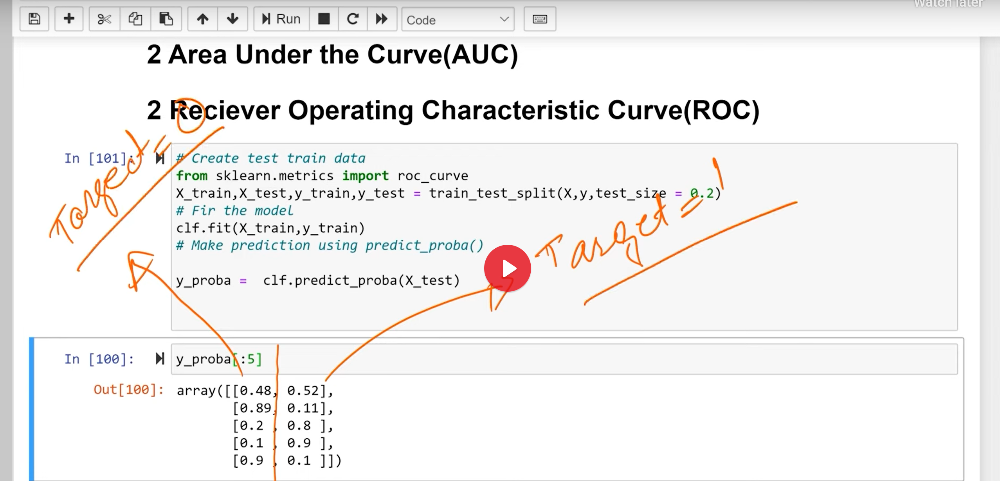

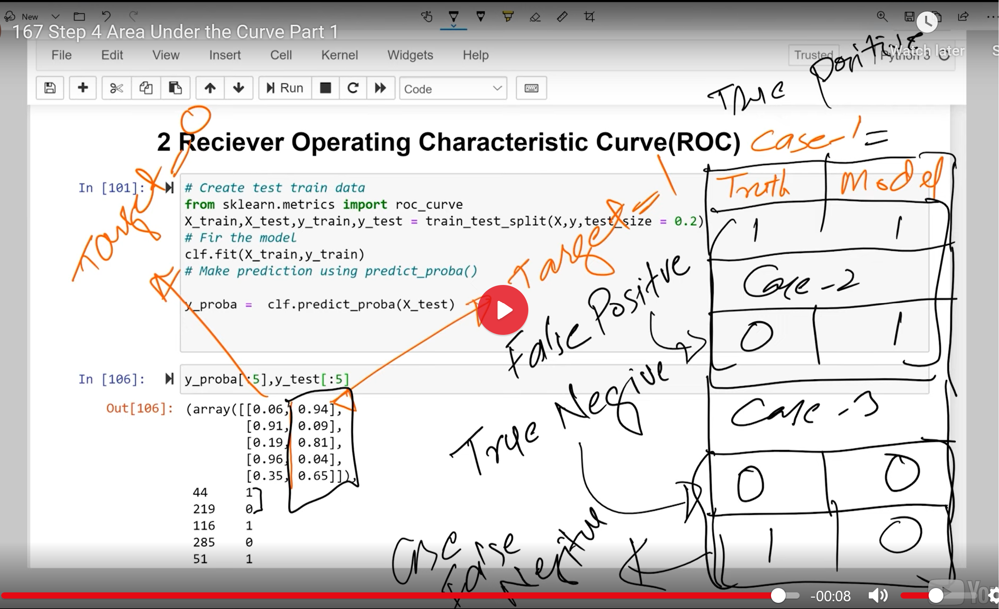

# 29: Step 4 Area Under the Curve Part 2 

In [115]:
# case 1 :True Positive =   Truth=1  Model=1
# case 2 :False Positive =  Truth=0  Model=1
# case 3 :True Negative =   Truth=0  Model=0
# case 4 :False Negative =  Truth=1  Model=0
from sklearn.metrics import roc_curve
from sklearn.metrics import auc

In [116]:
 30: Step 4 Area Under the Curve Part 3 Plotting 

SyntaxError: illegal target for annotation (3936276001.py, line 1)

In [117]:
fpr

array([0., 0., 1.])

# 30: Step 4 Area Under the Curve Part 3 Plotting 

In [138]:
import matplotlib.pyplot as plt

In [119]:
def plot_roc(fpr,tpr):
    plt.plot(fpr,tpr,color='red',label = 'AUC')
    plt.title("Area under the curve")
    plt.xlabel("False posssitve rate")
    plt.ylabel("True posssitve rate")
    plt.legend()
    plt.show()

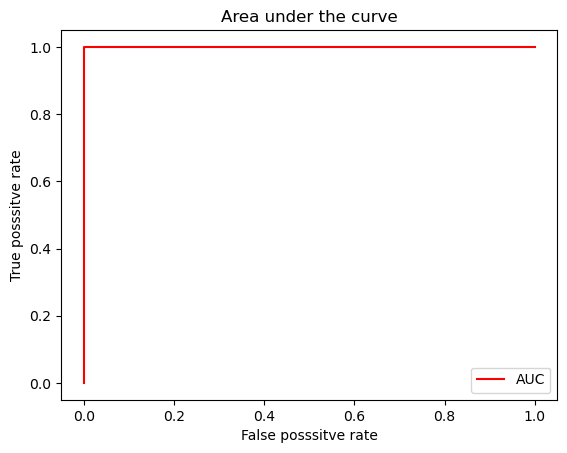

In [120]:
plot_roc(fpr,tpr)

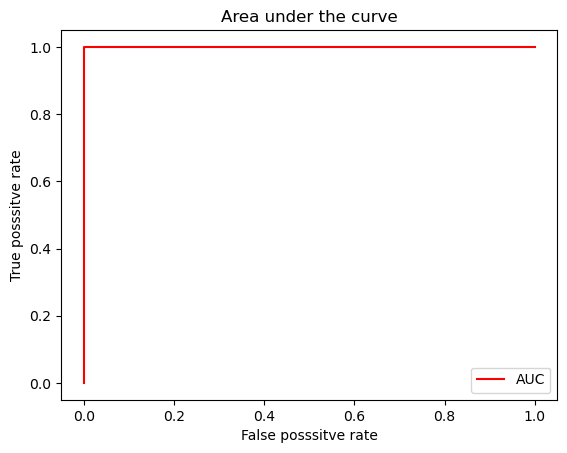

In [121]:
fpr,tpr,threshold = roc_curve(y_test,y_test)
plot_roc(fpr,tpr)

In [122]:
from sklearn.metrics import roc_curve
roc_auc_score(y_test,y_prob_possitive)

1.0